In [2]:
import findspark
findspark.init()

In [3]:
from pyspark.sql import SparkSession

In [4]:
spark=SparkSession.builder.config("spark-driver.host", "localhost").config("spark.driver.memory","4g") \
.config("spark.executor.memory","4g").appName("mr").getOrCreate()

In [5]:
spark

In [6]:
#import required libraries

from pyspark.sql import SparkSession
from pyspark.sql.functions import col,split
from pyspark.ml.recommendation import ALS
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.feature import StringIndexer
from pyspark.sql.functions import col, avg, count
from pyspark.ml import Pipeline
import plotly.express as px
from pyspark.sql import functions as F
import pandas as pd
import plotly.graph_objects as go
from pyspark.sql.functions import col, regexp_extract
from pyspark.sql.functions import collect_list, concat_ws
from wordcloud import WordCloud
from jupyter_dash import JupyterDash
from dash import  dcc
from dash import html
import plotly.express as px

In [7]:
# Initialize Spark session
spark = SparkSession.builder \
    .appName("Connect to HDFS") \
    .config("spark.hadoop.fs.defaultFS", "hdfs://10.0.2.15:9000") \
    .getOrCreate()

# Test HDFS access by listing files
hdfs_path = "hdfs:10.0.2.15:9000/user/Group04/Books.csv"
df = spark.read.csv(hdfs_path, header=True, inferSchema=True)
df.show(5)

In [8]:
df = df.na.drop("any")
df = df.dropDuplicates()
df.show(5)

+--------------------+--------------------+--------------------+--------------------+--------------------+--------------------+-------------+--------------------+--------------------+------------+----------+-----+--------------+--------------------+------------------+------------+-----------+--------------------+--------------------+
|               Title|         description|             authors|               image|         previewLink|           publisher|publishedDate|            infoLink|          categories|ratingsCount|        Id|Price|       User_id|         profileName|review/helpfulness|review/score|review/time|      review/summary|         review/text|
+--------------------+--------------------+--------------------+--------------------+--------------------+--------------------+-------------+--------------------+--------------------+------------+----------+-----+--------------+--------------------+------------------+------------+-----------+--------------------+--------------

In [9]:
sampled_df = df.sample(withReplacement=False, fraction=0.01)

In [10]:
#Top authors based on the review score of their books

sampled_df = sampled_df.filter(col('authors').rlike(r'^\[\'[A-Za-z\s]+\']$'))
top_authors = sampled_df.groupBy('authors').agg(
    F.count('review/score').alias('review_count')
)

# Convert to Pandas for further manipulation and sorting
top_authors_pd = top_authors.toPandas()

# Sort by review_count and select top 5
top_authors_sorted = top_authors_pd.sort_values(by='review_count',ascending=False).head(5)

#Visualization:

fig1 = px.bar(
    top_authors_sorted,
    x='authors',
    y=['review_count'],
    title='Top Authors based on Books Review Count',
    labels={'Count_review_score': 'Review Score Count', 'authors': 'Authors'})

fig1.show()

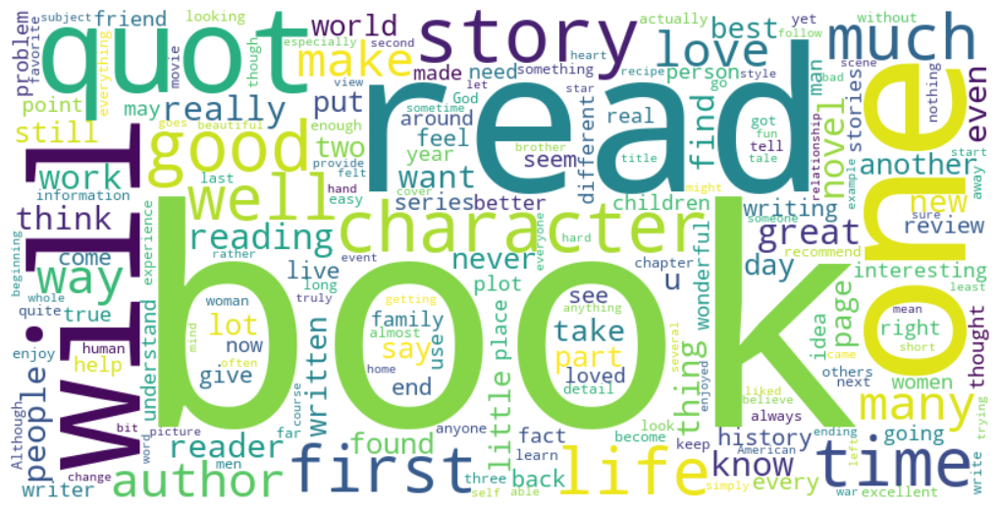

In [11]:
#Word cloud to know the Book titles
import matplotlib.pyplot as plt

reviews = sampled_df.agg(concat_ws(" ", collect_list("review/text"))).collect()[0][0]

# Generate word cloud
wordcloud = WordCloud(width=800, height=400, background_color="white").generate(reviews)

# Convert to image
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.tight_layout(pad=0)

# Save and display with Plotly
plt.savefig("title_wordcloud.png")
fig2 = go.Figure(go.Image(z=wordcloud))
fig2.update_layout(title="Word Cloud of Book Titles")
fig2.show()



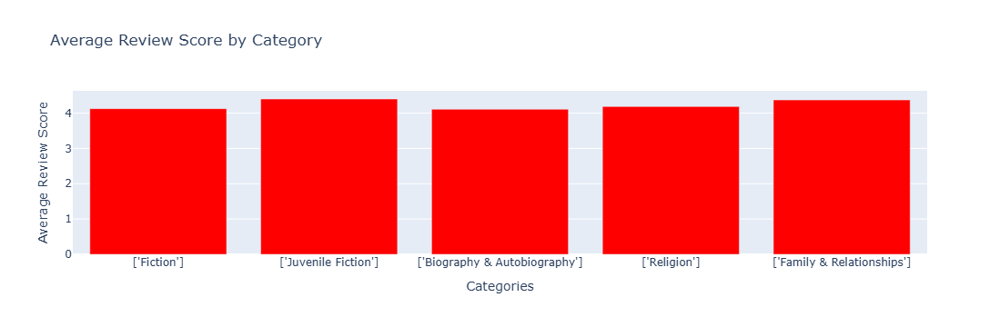

In [13]:
#Review based on Category

avg_review_by_category = sampled_df.groupBy('categories').agg(
    F.avg('review/score').alias('avg_review_score'),
    F.count('review/score').alias('review_count')
)

# Convert to Pandas for further manipulation and sorting
avg_review_by_category_pd = avg_review_by_category.toPandas()

# Sort by review_count and select top 5
category_review_sorted = avg_review_by_category_pd.sort_values(by='review_count',ascending=False).head(5)

fig3 = px.bar(category_review_sorted, x='categories', y='avg_review_score',
              title='Average Review Score by Category',
              labels={'avg_review_score': 'Average Review Score', 'categories': 'Categories'},color_discrete_sequence=['red','green','blue']
             )
fig3.show()


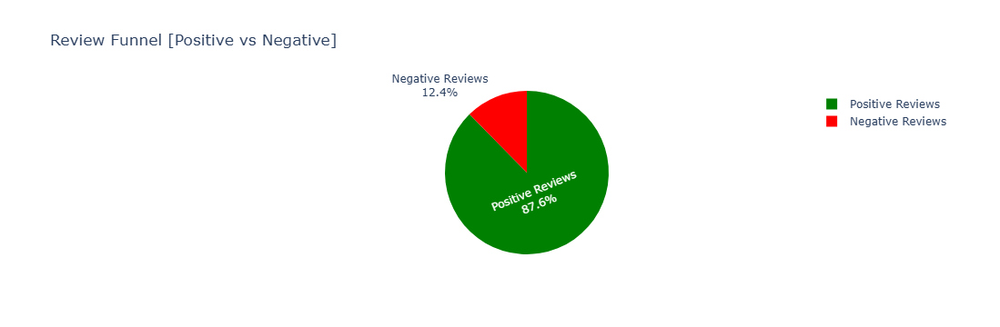

In [14]:
#Review Funnel

#using review/score , take positive and negative reviewsbased on threshold selected
sampled_df = sampled_df.withColumn(
    'positive_reviews', F.when(F.col('review/score') >= 3, 1).otherwise(0)
).withColumn(
    'negative_reviews', F.when(F.col('review/score') < 3, 1).otherwise(0)
)

# Aggregate total positive and negative reviews
review_funnel = sampled_df.agg(
    F.sum('positive_reviews').alias('Positive Reviews'),
    F.sum('negative_reviews').alias('Negative Reviews')
)

# Convert to Pandas
review_funnel_pd = review_funnel.toPandas()

# Transform the Pandas DataFrame for Plotly pie chart
review_funnel_pd = review_funnel_pd.melt(
    var_name='Review Type', value_name='Count'
)

# plot
fig4 = px.pie(
    review_funnel_pd,
    names='Review Type',  
    values='Count',     
    title='Review Funnel [Positive vs Negative]',
    color='Review Type', 
    color_discrete_map={
        'Positive Reviews': 'green', 
        'Negative Reviews': 'red'  
    }
)

fig4.update_traces(textinfo='percent+label')
fig4.show()


In [15]:
#  Unique Users Count


unique_user_count = sampled_df.select('User_id').distinct().count()


fig5 = go.Figure()

fig5.add_trace(go.Indicator(
    mode="number",
    value=unique_user_count,
    title={"text": "Total Unique Users"},
    number={"font": {"color": "white"}},  
))


fig5.update_layout(
    paper_bgcolor="maroon",  
    font={"color": "white"}    
)

fig5.show()


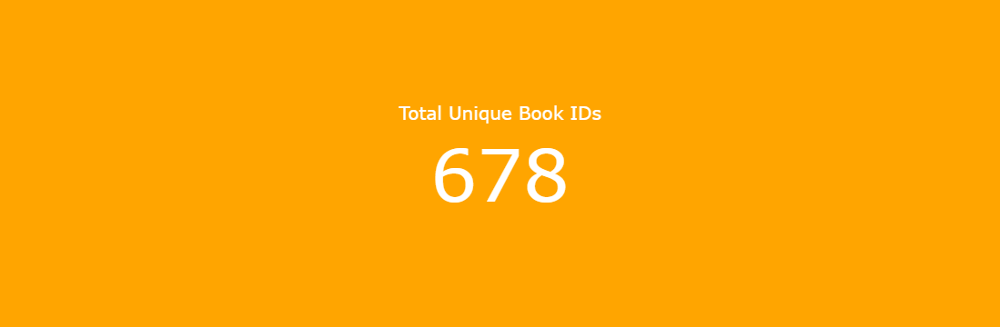

In [16]:
#Unique Book Id count

unique_book_count = sampled_df.select('Id').distinct().count()

#plot


fig6 = go.Figure()
fig6.add_trace(go.Indicator(
    mode="number",
    value=unique_book_count,
    title={"text": "Total Unique Book IDs"},
    number={"font": {"color": "white"}},  
))


fig6.update_layout(
    paper_bgcolor="Orange",  
    font={"color": "white"}    
)

fig6.show()



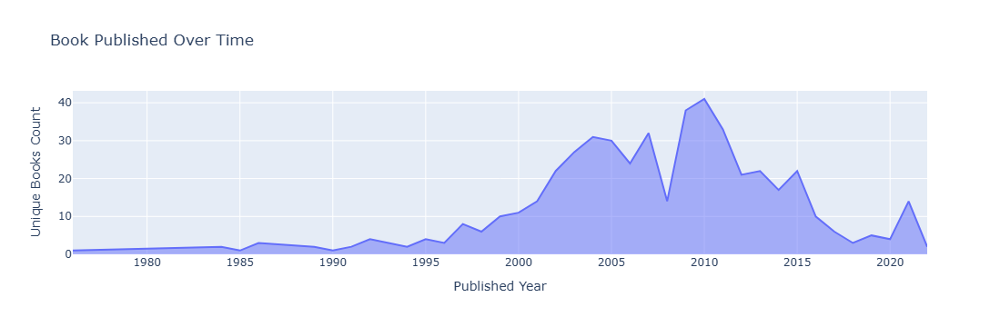

In [17]:
#Books Published over time

sampled_df = sampled_df.withColumn('published_year', F.year(F.to_date('publishedDate', 'yyyy-MM-dd')))

# Group by year and count unique book IDs
books_over_time = sampled_df.groupBy('published_year').agg(
    F.countDistinct('Id').alias('unique_books_count')
).orderBy('published_year')

# Convert to Pandas for visualization
books_over_time_pd = books_over_time.toPandas()

# Plot: Area Chart
fig7 = px.area(
    books_over_time_pd,
    x='published_year',
    y='unique_books_count',
    title='Book Published Over Time',
    labels={'unique_books_count': 'Unique Books Count', 'published_year': 'Published Year'}
)
fig7.update_layout(xaxis_title='Published Year', yaxis_title='Unique Books Count')
fig7.show()

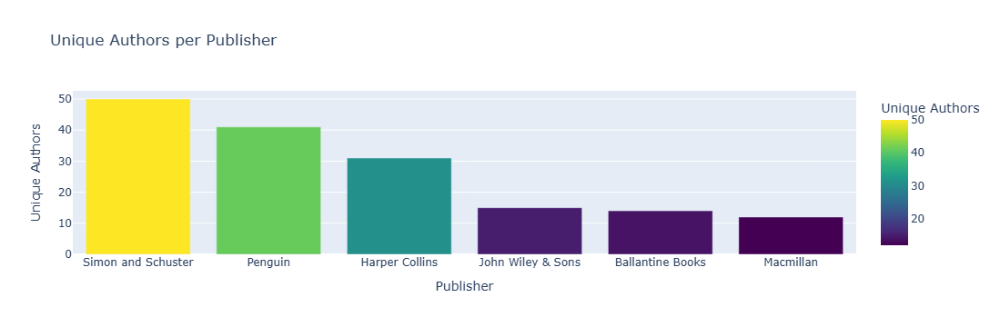

In [18]:
#Publisher published  count distinct 'authors'

authors_by_publisher = sampled_df.groupBy('publisher').agg(
    F.countDistinct('authors').alias('unique_authors')
).orderBy(F.col('unique_authors').desc())

# Top count
top_authors_by_publisher = authors_by_publisher.limit(6)

# Convert the result to a Pandas DataFrame for visualization
authors_by_publisher_pd = top_authors_by_publisher.toPandas()

# bar chart to visualize the result
fig8 = px.bar(
    authors_by_publisher_pd,
    x='publisher',
    y='unique_authors',
    title='Unique Authors per Publisher',
    labels={'unique_authors': 'Unique Authors', 'publisher': 'Publisher'},
    color='unique_authors',
    color_continuous_scale='Viridis'
)

# Plot
fig8.show()

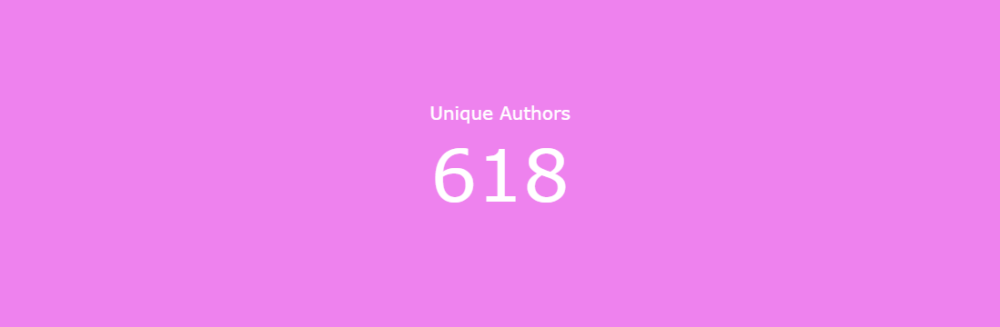

In [19]:
#Unique Count of authors

distinct_authors_count = sampled_df.select(F.countDistinct('authors')).collect()[0][0]

fig9 = go.Figure()
fig9.add_trace(go.Indicator(
    mode="number",
    value=distinct_authors_count,
    title={"text": "Unique Authors"},
    number={"font": {"color": "white"}},  
))


fig9.update_layout(
    paper_bgcolor="Violet",  
    font={"color": "white"}    
)

fig9.show()


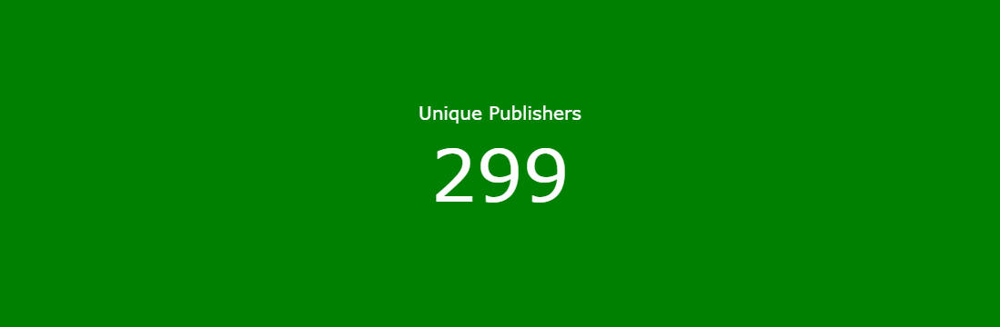

In [20]:
#Publishers count

distinct_publishers_count = sampled_df.select(F.countDistinct('publisher')).collect()[0][0]

fig10= go.Figure()
fig10.add_trace(go.Indicator(
    mode="number",
    value=distinct_publishers_count,
    title={"text": "Unique Publishers"},
    number={"font": {"color": "white"}},  
))


fig10.update_layout(
    paper_bgcolor="Green",  
    font={"color": "white"}    
)

fig10.show()


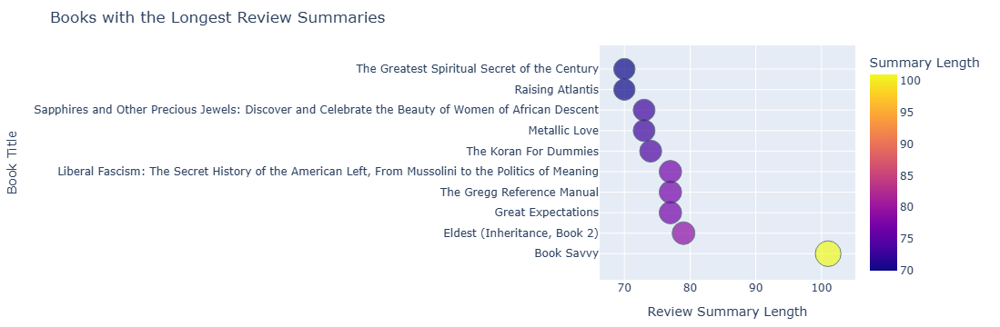

In [21]:
#Books with long Review Summary

sampled_df = sampled_df.withColumn('review_summary_length', F.length(F.col('review/summary')))

# Find the top 10 books with the longest review summaries
longest_reviews_df = sampled_df.select('Title', 'review/summary', 'review_summary_length').orderBy(
    F.col('review_summary_length').desc()
).limit(10)

# Convert to Pandas
longest_reviews_pd = longest_reviews_df.toPandas()

fig11 = px.scatter(
    longest_reviews_pd,
    x='review_summary_length',
    y='Title',
    size='review_summary_length',  
    color='review_summary_length',  
    title='Books with the Longest Review Summaries',
    labels={'review_summary_length': 'Review Summary Length', 'Title': 'Book Title'}
)

# Customize the chart
fig11.update_traces(
    textposition='top center',
    marker=dict(line=dict(width=1, color='DarkSlateGrey'))
)
fig11.update_layout(
    xaxis_title='Review Summary Length',
    yaxis_title='Book Title',
    coloraxis_colorbar=dict(title="Summary Length"),
    margin=dict(t=50, l=50, r=50, b=50),
    showlegend=False
)

# Show the plot
fig11.show()

In [ ]:
from dash import Dash, dcc, html
from dash.dependencies import Input, Output
import plotly.graph_objects as go


app.layout = html.Div(
    children=[
        # Title Section
        html.Div(
            children=[
                html.H1(
                    "Book Recommendations & Analytics Dashboard",
                    style={
                        "textAlign": "center",
                        "color": "#ffffff",
                        "fontWeight": "bold",
                        "fontSize": "2.5em",
                        "backgroundColor": "#FF6F61",  # Background color for the title section
                        "padding": "20px",
                        "borderRadius": "10px",
                        "boxShadow": "0px 4px 10px rgba(0,0,0,0.3)",
                    },
                )
            ],
            style={"marginBottom": "30px"},
        ),
        
        # Figures Section
        html.Div(
            children=[
                #Row 1
                html.Div(
                    children=[
                        html.Div([
                            html.H3(
                                "Unique Authors", 
                                style={
                                    "textAlign": "center", 
                                    "color": "#FFFFFF",
                                    "backgroundColor": "#9C27B0",
                                    "padding": "10px",
                                    "borderRadius": "5px",
                                    "boxShadow": "0px 2px 4px rgba(0,0,0,0.1)"
                                }
                            ),
                            dcc.Graph(id="fig9", figure=fig9),
                        ], style={"backgroundColor": "#2C3E50", "borderRadius": "8px", "padding": "15px", "width": "48%", "boxShadow": "0px 4px 6px rgba(0,0,0,0.3)", "marginRight": "4%"}),  # Adjust right margin

                        html.Div([
                            html.H3(
                                "Unique Publishers", 
                                style={
                                    "textAlign": "center", 
                                    "color": "#FFFFFF",
                                    "backgroundColor": "#E91E63",
                                    "padding": "10px",
                                    "borderRadius": "5px",
                                    "boxShadow": "0px 2px 4px rgba(0,0,0,0.1)"
                                }
                            ),
                            dcc.Graph(id="fig10", figure=fig10),
                        ], style={"backgroundColor": "#2C3E50", "borderRadius": "8px", "padding": "15px", "width": "48%", "boxShadow": "0px 4px 6px rgba(0,0,0,0.3)", "marginLeft": "4%"}),  # Adjust left margin
                    ],
                    style={"display": "flex", "justifyContent": "space-between", "marginBottom": "30px"}
                ),
                #Row 2
                   html.Div(
                    children=[
                        html.Div([
                            html.H3(
                                "Total Unique Users", 
                                style={
                                    "textAlign": "center", 
                                    "color": "#FFFFFF",
                                    "backgroundColor": "#FF5722",
                                    "padding": "10px",
                                    "borderRadius": "5px",
                                    "boxShadow": "0px 2px 4px rgba(0,0,0,0.1)"
                                }
                            ),
                            dcc.Graph(id="fig5", figure=fig5),
                        ], style={"backgroundColor": "#2C3E50", "borderRadius": "8px", "padding": "15px", "width": "48%", "boxShadow": "0px 4px 6px rgba(0,0,0,0.3)", "marginRight": "4%"}),  # Adjust right margin

                        html.Div([
                            html.H3(
                                "Total Unique Book IDs", 
                                style={
                                    "textAlign": "center", 
                                    "color": "#FFFFFF",
                                    "backgroundColor": "#009688",
                                    "padding": "10px",
                                    "borderRadius": "5px",
                                    "boxShadow": "0px 2px 4px rgba(0,0,0,0.1)"
                                }
                            ),
                            dcc.Graph(id="fig6", figure=fig6),
                        ], style={"backgroundColor": "#2C3E50", "borderRadius": "8px", "padding": "15px", "width": "48%", "boxShadow": "0px 4px 6px rgba(0,0,0,0.3)", "marginLeft": "4%"}),  # Adjust left margin
                    ],
                    style={"display": "flex", "justifyContent": "space-between", "marginBottom": "30px"}
                ),
                # Row 3
                html.Div(
                    children=[
                        html.Div([
                            html.H3(
                                "Top Authors Based on Review Count", 
                                style={
                                    "textAlign": "center", 
                                    "color": "#FFFFFF",
                                    "backgroundColor": "#4CAF50",
                                    "padding": "10px",
                                    "borderRadius": "5px",
                                    "boxShadow": "0px 2px 4px rgba(0,0,0,0.1)"
                                }
                            ),
                            dcc.Graph(id="fig1", figure=fig1),
                        ], style={"backgroundColor": "#2C3E50", "borderRadius": "8px", "padding": "15px", "width": "48%", "boxShadow": "0px 4px 6px rgba(0,0,0,0.3)", "marginRight": "4%"}),  # Adjust right margin

                        html.Div([
                            html.H3(
                                "Word Cloud of Book Titles", 
                                style={
                                    "textAlign": "center", 
                                    "color": "#FFFFFF",
                                    "backgroundColor": "#FF9800",
                                    "padding": "10px",
                                    "borderRadius": "5px",
                                    "boxShadow": "0px 2px 4px rgba(0,0,0,0.1)"
                                }
                            ),
                            dcc.Graph(id="fig2", figure=fig2),
                        ], style={"backgroundColor": "#2C3E50", "borderRadius": "8px", "padding": "15px", "width": "48%", "boxShadow": "0px 4px 6px rgba(0,0,0,0.3)", "marginLeft": "4%"}),  # Adjust left margin
                    ],
                    style={"display": "flex", "justifyContent": "space-between", "marginBottom": "30px"}
                ),

                # Row 4
                html.Div(
                    children=[
                        html.Div([
                            html.H3(
                                "Average Review Score by Category", 
                                style={
                                    "textAlign": "center", 
                                    "color": "#FFFFFF",
                                    "backgroundColor": "#3F51B5",
                                    "padding": "10px",
                                    "borderRadius": "5px",
                                    "boxShadow": "0px 2px 4px rgba(0,0,0,0.1)"
                                }
                            ),
                            dcc.Graph(id="fig3", figure=fig3),
                        ], style={"backgroundColor": "#2C3E50", "borderRadius": "8px", "padding": "15px", "width": "48%", "boxShadow": "0px 4px 6px rgba(0,0,0,0.3)", "marginRight": "4%"}),  # Adjust right margin

                        html.Div([
                            html.H3(
                                "Review Funnel (Positive vs Negative)", 
                                style={
                                    "textAlign": "center", 
                                    "color": "#FFFFFF",
                                    "backgroundColor": "#2196F3",
                                    "padding": "10px",
                                    "borderRadius": "5px",
                                    "boxShadow": "0px 2px 4px rgba(0,0,0,0.1)"
                                }
                            ),
                            dcc.Graph(id="fig4", figure=fig4),
                        ], style={"backgroundColor": "#2C3E50", "borderRadius": "8px", "padding": "15px", "width": "48%", "boxShadow": "0px 4px 6px rgba(0,0,0,0.3)", "marginLeft": "4%"}),  # Adjust left margin
                    ],
                    style={"display": "flex", "justifyContent": "space-between", "marginBottom": "30px"}
                ),

                # Row 5
                html.Div(
                    children=[
                        html.Div([
                            html.H3(
                                "Books Published Over Time", 
                                style={
                                    "textAlign": "center", 
                                    "color": "#FFFFFF",
                                    "backgroundColor": "#673AB7",
                                    "padding": "10px",
                                    "borderRadius": "5px",
                                    "boxShadow": "0px 2px 4px rgba(0,0,0,0.1)"
                                }
                            ),
                            dcc.Graph(id="fig7", figure=fig7),
                        ], style={"backgroundColor": "#2C3E50", "borderRadius": "8px", "padding": "15px", "width": "48%", "boxShadow": "0px 4px 6px rgba(0,0,0,0.3)", "marginRight": "4%"}),  # Adjust right margin

                        html.Div([
                            html.H3(
                                "Books Published by Publisher", 
                                style={
                                    "textAlign": "center", 
                                    "color": "#FFFFFF",
                                    "backgroundColor": "#795548",
                                    "padding": "10px",
                                    "borderRadius": "5px",
                                    "boxShadow": "0px 2px 4px rgba(0,0,0,0.1)"
                                }
                            ),
                            dcc.Graph(id="fig8", figure=fig8),
                        ], style={"backgroundColor": "#2C3E50", "borderRadius": "8px", "padding": "15px", "width": "48%", "boxShadow": "0px 4px 6px rgba(0,0,0,0.3)", "marginLeft": "4%"}),  # Adjust left margin
                    ],
                    style={"display": "flex", "justifyContent": "space-between", "marginBottom": "30px"}
                ),
               
                # Row 6 
                html.Div(
                    children=[
                        html.Div([
                            html.H3(
                                "Books with the Longest Review Summaries", 
                                style={
                                    "textAlign": "center", 
                                    "color": "#FFFFFF",
                                    "backgroundColor": "#2196F3",
                                    "padding": "10px",
                                    "borderRadius": "5px",
                                    "boxShadow": "0px 2px 4px rgba(0,0,0,0.1)"
                                }
                            ),
                            dcc.Graph(id="fig11", figure=fig11),
                        ], style={"backgroundColor": "#2C3E50", "borderRadius": "8px", "padding": "15px", "width": "48%", "boxShadow": "0px 4px 6px rgba(0,0,0,0.3)", "marginLeft": "4%"}),  # Adjust left margin
                    ],
                    style={"display": "flex", "justifyContent": "center",  "alignItems": "center", "marginBottom": "30px" }
                ),

            ]
        ),
    ],
    style={"backgroundColor": "#263238", "color": "white", "fontFamily": "Arial, sans-serif", "padding": "30px"},
)

if __name__ == "__main__":
    app.run_server(mode="internal")


In [ ]:
#stop the spark

spark.stop()